In [109]:
import cenpy
import osmnx as ox
import matplotlib.pyplot as plt
from shapely.geometry import Point

%matplotlib inline

In [113]:
# P010004

losangeles_data = cenpy.products.Decennial2010().from_county('Los Angeles County, CA', level='tract', 
                                           variables=['P010004', 'P010002', 'P011002', 'P011001'])

C:\Users\Ryan\.conda\envs\final\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [96]:
project_site = (33.9379368079315, -118.25653793837309)
dist = 4820

latlng_point = Point(project_site[1], project_site[0])

bbox = ox.utils_geo.bbox_from_point(project_site, dist=dist) #create bounding box for plotting

latlng_point_proj, crs = ox.projection.project_geometry(latlng_point) #projected in meters (UTM)
polygon_proj = latlng_point_proj.buffer(dist, cap_style=3) #do meaningful operations in the meter projection, style 3 is square
polygon, crs = ox.projection.project_geometry(polygon_proj, crs=crs, to_latlong=True) #reproject to latlong

watts_graph = ox.graph_from_polygon(polygon, network_type='all_private', truncate_by_edge=True)
# watts_graph = ox.graph_from_point(project_site, dist=4820, network_type='all_private', truncate_by_edge=True)

In [80]:
watts_nodes, watts_streets  = ox.graph_to_gdfs(watts_graph)

In [81]:
losangeles_data = losangeles_data.to_crs(watts_streets.crs)

In [86]:
losangeles_data = losangeles_data.eval('pct_afam = P010004 / P010002')

array([-118.3204534, -118.195296 ,   33.8855381,   33.985437 ])

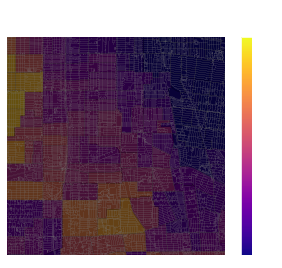

In [106]:
dat = losangeles_data.plot('pct_afam', cmap='plasma', alpha=.4, linewidth=.25, edgecolor='k', legend=True)
fig, ax = ox.plot_graph(watts_graph, ax=dat, node_size=0, edge_linewidth=0.1,
                        edge_color='gray', show=False, close=False, bbox=bbox)

ax.set_title('Watts, CA\nAfrican American %')

plt.savefig('figures/watts_pct_afam.png', bbox_inches='tight',dpi=400, facecolor='#111111')

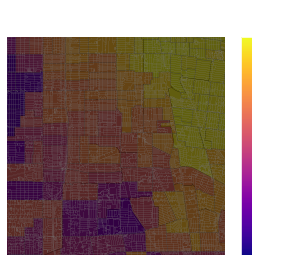

In [107]:
losangeles_data = losangeles_data.eval('pct_latino = P011002 / P011001')

dat = losangeles_data.plot('pct_latino', cmap='plasma', alpha=.4, linewidth=.25, edgecolor='k', legend=True)
fig, ax = ox.plot_graph(watts_graph, ax=dat, node_size=0, edge_linewidth=0.1,
                        edge_color='gray', show=False, close=False, bbox=bbox)

ax.set_title('Watts, CA\nLatino %')

plt.savefig('figures/watts_pct_latino.png', bbox_inches='tight',dpi=400, facecolor='#111111')